## TITLE : AIR QUALITY INDEX PREDICTION MODEL



Name: PRIYANKA P
Organization: Entri Elevate
Date: 28/05/2024

### INTRODUCTION

The Air Quality Index (AQI) is used for reporting daily air quality. It tells you how clean or polluted your air is, and what associated health effects might be a concern for you. The AQI focuses on health effects you may experience within a few hours or days after breathing polluted air.The purpose of the AQI is to educate the public on the negative health effects of local air pollution. The amount of air pollution in Indian cities has significantly increased.

### OBJECTIVE

The aim of this project is to develop the best AQI prediction model using machine learning techniques to assist in climate control.

### DATA DICTIONARY

The dataset is a collection of pollutant readings across cities in India recorded between 2015 and 2020. The data consists of 26 cities in India, and
is split into the following categories: -

Date - daily readings between 2015 and 2020 , PM2.5 - Particulate Matter 2.5-micrometer in (μg / m3 , PM10 - Particulate Matter 10-micrometer in (μg / m3
NO - Nitric Oxide in (μg / m3 , NO2 - Nitrogen Dioxide in (μg / m3 , NOx - Any Nitrogen oxides in ppb , NH3 - Ammonia in (μg / m3 , CO -CarbonMonoxide in (μg/ m3
SO2 - Sulphur Dioxide in (μg / m3 O3 - Ozone in (μg / m3 , Benzene - Benzene in (μg / m3 , Toluene - Toluene in (μg / m3 , Xylene - Xylene in (μg / m3
AQI - Air Quality Index , AQI Bucket - Air Quality Index Bucket (ranging from 'very poor' to 'good')

The data consist of 29531 rows and 16 columns

### DATA COLLECTION

#### IMPORTING LIBRARIES

In [169]:
import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

#### LOADING THE DATASET

In [170]:
df=pd.read_csv('city_day.csv')
df

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,Good
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,Satisfactory
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,Satisfactory
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,Satisfactory


## DATA EXPLORATION

In [171]:
#Display the first 5 rows of dataset
df.head()

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN


In [172]:
# Display the columns
df.columns

Index(['City', 'Date', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2',
       'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket'],
      dtype='object')

In [173]:
df.shape

(29531, 16)

In [174]:
# Display the data types, non-null counts, and memory usage.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29531 entries, 0 to 29530
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        29531 non-null  object 
 1   Date        29531 non-null  object 
 2   PM2.5       24933 non-null  float64
 3   PM10        18391 non-null  float64
 4   NO          25949 non-null  float64
 5   NO2         25946 non-null  float64
 6   NOx         25346 non-null  float64
 7   NH3         19203 non-null  float64
 8   CO          27472 non-null  float64
 9   SO2         25677 non-null  float64
 10  O3          25509 non-null  float64
 11  Benzene     23908 non-null  float64
 12  Toluene     21490 non-null  float64
 13  Xylene      11422 non-null  float64
 14  AQI         24850 non-null  float64
 15  AQI_Bucket  24850 non-null  object 
dtypes: float64(13), object(3)
memory usage: 3.6+ MB


In [175]:
#Statistical summary
df.describe()

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
count,24933.000000,18391.000000,25949.000000,25946.000000,25346.000000,19203.000000,27472.000000,25677.000000,25509.000000,23908.000000,21490.000000,11422.000000,24850.000000
mean,67.450578,118.127103,17.574730,28.560659,32.309123,23.483476,2.248598,14.531977,34.491430,3.280840,8.700972,3.070128,166.463581
std,64.661449,90.605110,22.785846,24.474746,31.646011,25.684275,6.962884,18.133775,21.694928,15.811136,19.969164,6.323247,140.696585
min,0.040000,0.010000,0.020000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,13.000000
25%,28.820000,56.255000,5.630000,11.750000,12.820000,8.580000,0.510000,5.670000,18.860000,0.120000,0.600000,0.140000,81.000000
50%,48.570000,95.680000,9.890000,21.690000,23.520000,15.850000,0.890000,9.160000,30.840000,1.070000,2.970000,0.980000,118.000000
75%,80.590000,149.745000,19.950000,37.620000,40.127500,30.020000,1.450000,15.220000,45.570000,3.080000,9.150000,3.350000,208.000000
max,949.990000,1000.000000,390.680000,362.210000,467.630000,352.890000,175.810000,193.860000,257.730000,455.030000,454.850000,170.370000,2049.000000


In [176]:
df.duplicated().sum()

0

In [177]:
df.nunique()

City             26
Date           2009
PM2.5         11716
PM10          12571
NO             5776
NO2            7404
NOx            8156
NH3            5922
CO             1779
SO2            4761
O3             7699
Benzene        1873
Toluene        3608
Xylene         1561
AQI             829
AQI_Bucket        6
dtype: int64

In [178]:
# Checking the null values
df.isnull().sum()

City              0
Date              0
PM2.5          4598
PM10          11140
NO             3582
NO2            3585
NOx            4185
NH3           10328
CO             2059
SO2            3854
O3             4022
Benzene        5623
Toluene        8041
Xylene        18109
AQI            4681
AQI_Bucket     4681
dtype: int64

#### Here we can see there are lot of null values in the dataset.And the features Xylene,NH3 has more null values so lets drop that column & is not a critical feature to predict AQI. So the next part is to remove the null values using suitable method

In [179]:
df.drop(['Xylene','NH3'] ,axis=1, inplace=True)

## DATA PREPROCESSING

In [180]:
#converting the dtype of date column to datetime

df['Date']=df['Date'].apply(pd.to_datetime)
#setting datecolumn as index
df.set_index('Date',inplace=True)

In [181]:
# Filling the null values using mean method

df['PM2.5'].fillna(df['PM2.5'].mean(),inplace=True),
df['PM10'].fillna(df['PM10'].mean(),inplace=True),
df['AQI'].fillna(df['AQI'].mean(),inplace=True),
df['NO'].fillna(df['NO'].mean(),inplace=True),
df['NO2'].fillna(df['NO2'].mean(),inplace=True),
df['NOx'].fillna(df['NOx'].mean(),inplace=True),
df['CO'].fillna(df['CO'].mean(),inplace=True),
df['SO2'].fillna(df['SO2'].mean(),inplace=True),
df['O3'].fillna(df['O3'].mean(),inplace=True),
df['Benzene'].fillna(df['Benzene'].mean(),inplace=True),
df['Toluene'].fillna(df['Toluene'].mean(),inplace=True),
df

,City,PM2.5,PM10,NO,NO2,NOx,CO,SO2,O3,Benzene,Toluene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.450578,118.127103,0.92,18.22,17.15,0.92,27.64,133.36,0.00000,0.020000,166.463581,NaN
2015-01-02,Ahmedabad,67.450578,118.127103,0.97,15.69,16.46,0.97,24.55,34.06,3.68000,5.500000,166.463581,NaN
2015-01-03,Ahmedabad,67.450578,118.127103,17.40,19.30,29.70,17.40,29.07,30.70,6.80000,16.400000,166.463581,NaN
2015-01-04,Ahmedabad,67.450578,118.127103,1.70,18.48,17.97,1.70,18.59,36.08,4.43000,10.140000,166.463581,NaN
2015-01-05,Ahmedabad,67.450578,118.127103,22.10,21.42,37.76,22.10,39.33,39.31,7.01000,18.890000,166.463581,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68,25.06,19.54,0.47,8.55,23.30,2.24000,12.070000,41.000000,Good
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42,26.06,16.53,0.52,12.72,30.14,0.74000,2.210000,70.000000,Satisfactory
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45,29.53,18.33,0.48,8.42,30.96,0.01000,0.010000,68.000000,Satisfactory


## AQI SCALE

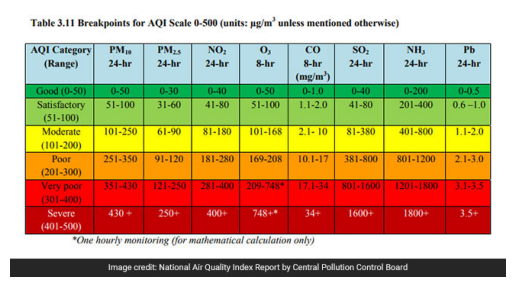

In [182]:
import matplotlib.image as mpimg

# Specify the path to your image
image_path = "aqi_image.jpg"

# Read and display the image
img = mpimg.imread(image_path)
plt.imshow(img)
plt.axis('off')  # Hide the axes
plt.show()

In [183]:
# Calculating AQI bucket value

def aqi_bucket(x):
    if x <=50:
        return"Good"
    elif x >50 and x <=100:
        return"Satisfactory"
    elif x >100 and x <=200:
        return"Moderate"
    elif x >200 and x <=300:
        return"Poor"
    elif x >300 and x <=400:
        return"Very Poor"
    elif x >400:
        return"Severe"
    else:
        return"Nothing"

df['AQI_Bucket']=df['AQI_Bucket'].fillna(df['AQI'].apply(lambda x:aqi_bucket(x)))
df.head()
        

,City,PM2.5,PM10,NO,NO2,NOx,CO,SO2,O3,Benzene,Toluene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,
2015-01-01,Ahmedabad,67.450578,118.127103,0.92,18.22,17.15,0.92,27.64,133.36,0.00,0.02,166.463581,Moderate
2015-01-02,Ahmedabad,67.450578,118.127103,0.97,15.69,16.46,0.97,24.55,34.06,3.68,5.50,166.463581,Moderate
2015-01-03,Ahmedabad,67.450578,118.127103,17.40,19.30,29.70,17.40,29.07,30.70,6.80,16.40,166.463581,Moderate
2015-01-04,Ahmedabad,67.450578,118.127103,1.70,18.48,17.97,1.70,18.59,36.08,4.43,10.14,166.463581,Moderate
2015-01-05,Ahmedabad,67.450578,118.127103,22.10,21.42,37.76,22.10,39.33,39.31,7.01,18.89,166.463581,Moderate


In [184]:
df.isnull().sum()

City          0
PM2.5         0
PM10          0
NO            0
NO2           0
NOx           0
CO            0
SO2           0
O3            0
Benzene       0
Toluene       0
AQI           0
AQI_Bucket    0
dtype: int64

#### Here all the null values are replaced using suitable methods

##### Let's check which city has the highest average value of pollutant

In [185]:
# Function to find the city with the highest average value for a given pollutant

def city_with_highest_avg(df, pollutant):
    average_values = df.groupby('City')[pollutant].mean()
    city = average_values.idxmax()
    value = average_values.max()
    return city, value

# Find the city with the highest average value for each pollutant
pollutants = ['SO2', 'NO', 'NO2','PM10','PM2.5','CO','O3','NOx','Benzene','Toluene']
results = {pollutant: city_with_highest_avg(df, pollutant) for pollutant in pollutants}

# Print the results
for pollutant, (city, value) in results.items():
    print(f"City with highest average {pollutant} value: {city}")
    print(f"Highest average {pollutant} value: {value}\n")
    

City with highest average SO2 value: Ahmedabad
Highest average SO2 value: 42.28114755788073

City with highest average NO value: Kochi
Highest average NO value: 71.10252752669173

City with highest average NO2 value: Delhi
Highest average NO2 value: 50.76305690299764

City with highest average PM10 value: Delhi
Highest average PM10 value: 228.41374660312104

City with highest average PM2.5 value: Delhi
Highest average PM2.5 value: 117.14663073962062

City with highest average CO value: Ahmedabad
Highest average CO value: 16.147419765720826

City with highest average O3 value: Bhopal
Highest average O3 value: 59.06129022242099

City with highest average NOx value: Kochi
Highest average NOx value: 68.4129012345679

City with highest average Benzene value: Shillong
Highest average Benzene value: 34.69060558080167

City with highest average Toluene value: Shillong
Highest average Toluene value: 35.37275177652021



#### FINDING & REMOVING OUTLIERS

<Axes: >

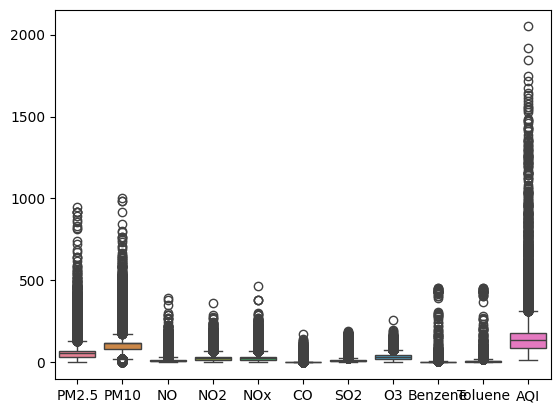

In [186]:
sns.boxplot(df)

In [187]:
# Function to remove outliers

def remove_outliers(data, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# List of columns to check for outliers
columns_to_check = ['PM2.5','PM10','NO','NO2','NOx','CO','SO2','O3','Benzene','Toluene','AQI']

# Apply the function to each column
for column in columns_to_check:
    df = remove_outliers(df, column)

# Display the dataset after removing outliers
df

,City,PM2.5,PM10,NO,NO2,NOx,CO,SO2,O3,Benzene,Toluene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,
2015-01-02,Ahmedabad,67.450578,118.127103,0.97000,15.690000,16.460000,0.970000,24.550000,34.06000,3.68000,5.500000,166.463581,Moderate
2015-01-04,Ahmedabad,67.450578,118.127103,1.70000,18.480000,17.970000,1.700000,18.590000,36.08000,4.43000,10.140000,166.463581,Moderate
2015-01-10,Ahmedabad,67.450578,118.127103,17.57473,7.040000,0.000000,2.248598,8.290000,4.55000,0.00000,0.000000,166.463581,Moderate
2015-02-04,Ahmedabad,80.650000,118.127103,2.37000,22.830000,24.000000,2.370000,25.730000,47.30000,0.00000,0.000000,294.000000,Poor
2015-02-26,Ahmedabad,67.450578,118.127103,17.57473,28.560659,32.309123,2.248598,14.531977,34.49143,3.28084,8.700972,166.463581,Moderate
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,Visakhapatnam,15.020000,50.940000,7.68000,25.060000,19.540000,0.470000,8.550000,23.30000,2.24000,12.070000,41.000000,Good
2020-06-28,Visakhapatnam,24.380000,74.090000,3.42000,26.060000,16.530000,0.520000,12.720000,30.14000,0.74000,2.210000,70.000000,Satisfactory
2020-06-29,Visakhapatnam,22.910000,65.730000,3.45000,29.530000,18.330000,0.480000,8.420000,30.96000,0.01000,0.010000,68.000000,Satisfactory


In [188]:
df.shape

(17698, 13)

<Axes: >

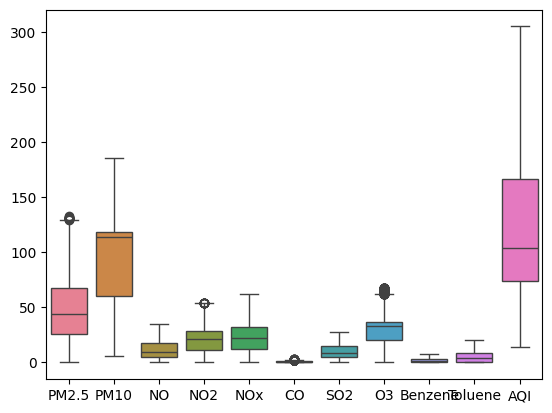

In [189]:
sns.boxplot(df)

### By analyzing this we understood that the outliers are removed

<Axes: ylabel='Density'>

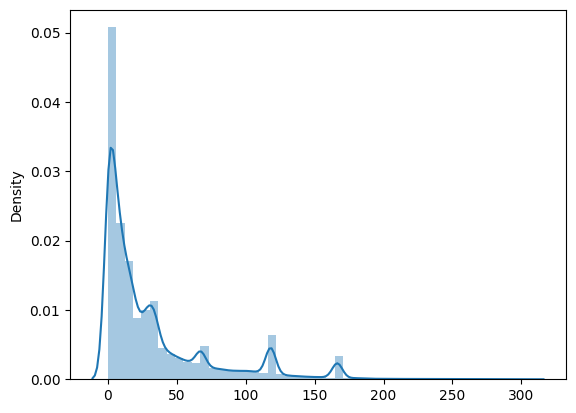

In [190]:
# Checking the skewness of data

sns.distplot(df [['PM2.5','PM10','NO','NO2','NOx','CO','SO2','O3','Benzene','Toluene','AQI']])

In [191]:
df [['PM2.5','PM10','NO','NO2','NOx','CO','SO2','O3','Benzene','Toluene','AQI']].skew()

PM2.5      0.380615
PM10      -0.378737
NO         0.617023
NO2        0.345108
NOx        0.195205
CO         0.753433
SO2        0.611925
O3         0.205606
Benzene    0.754009
Toluene    0.514216
AQI        0.567778
dtype: float64

By analysing these values, features like PM1O,NO,CO,SO2,Benzene,Xylene are highly skewed. 
 
Normalization can be done using various techniques such as log transformation, square root transformation, or Box-Cox transformation.
For simplicity, I'll use the PowerTransformer from sklearn.preprocessing, which can apply Box-Cox or Yeo-Johnson transformations.


In [192]:
from sklearn.preprocessing import PowerTransformer

# Selecting features to normalize
features_to_normalize = ['PM10', 'NO', 'CO', 'SO2', 'Benzene']

# Applying PowerTransformer
pt = PowerTransformer(method='yeo-johnson')  # Yeo-Johnson works with zero and negative values
df[features_to_normalize] = pt.fit_transform(df[features_to_normalize])


In [193]:
df[['PM10', 'NO', 'CO', 'SO2', 'Benzene']].skew()

PM10      -0.233891
NO        -0.080029
CO         0.010153
SO2       -0.044985
Benzene    0.033728
dtype: float64

## DATA VISUALIZATION

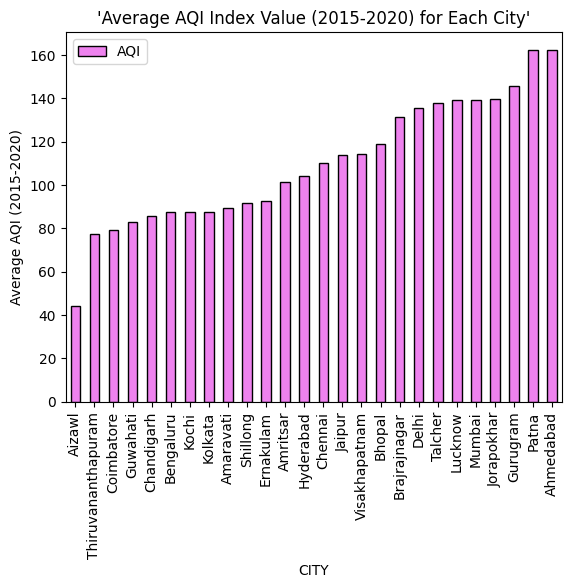

<Figure size 800x800 with 0 Axes>

In [194]:
df[['City','AQI']].groupby('City').mean().sort_values('AQI').plot(kind='bar',color='violet',edgecolor='black')
plt.title("'Average AQI Index Value (2015-2020) for Each City'")
plt.xticks(rotation='vertical')
plt.xlabel('CITY')
plt.ylabel('Average AQI (2015-2020)')
plt.figure(figsize=(8,8))
plt.show()

#### From the above plot we can conclude 'AHMEDABAD' is the highest polluted city followed by PATNA & GURUGRAM

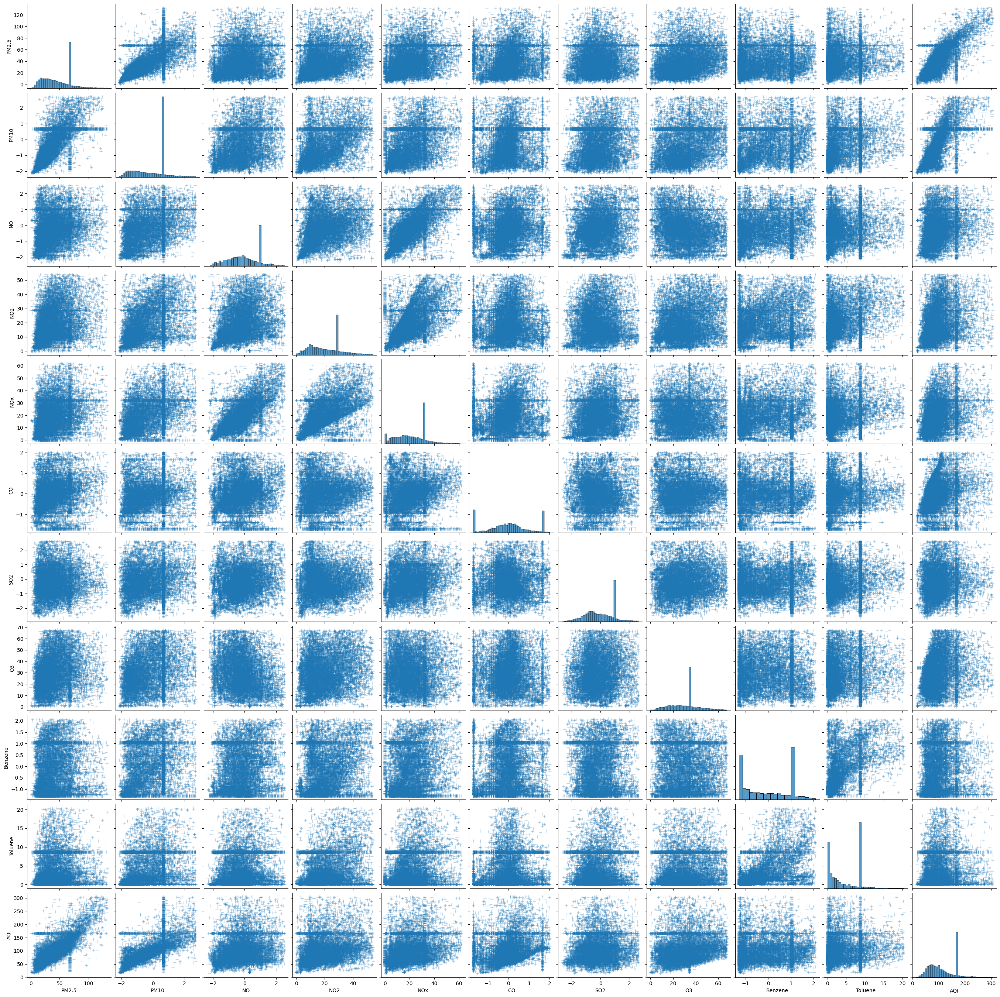

In [195]:
sns.pairplot(df, markers='+', plot_kws={'alpha':0.5})

Text(0.5, 1.0, 'Distribution Of Pollutants Over 5 Years')

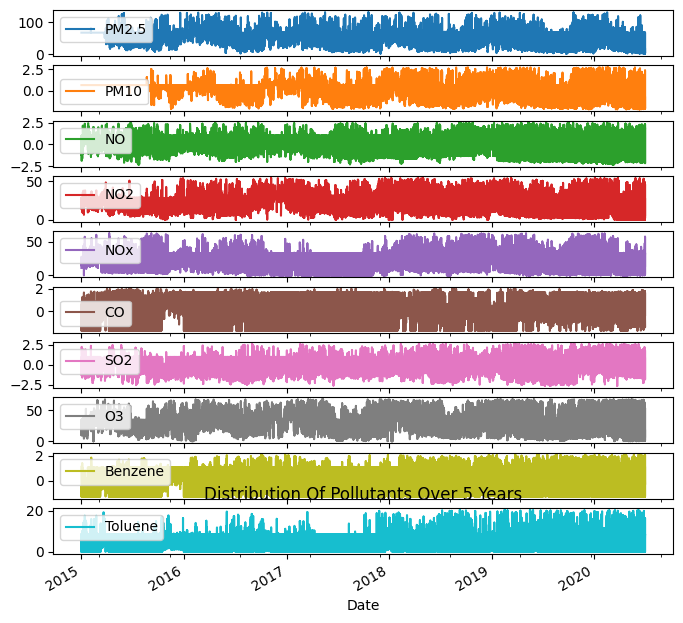

In [196]:
data=df.copy()
pollutants=['PM2.5','PM10','NO','NO2','NOx','CO','SO2','O3','Benzene','Toluene']
data=data[pollutants]
data.plot(kind='line',fontsize=10,figsize=(8,8),subplots=True)
plt.title("Distribution Of Pollutants Over 5 Years")

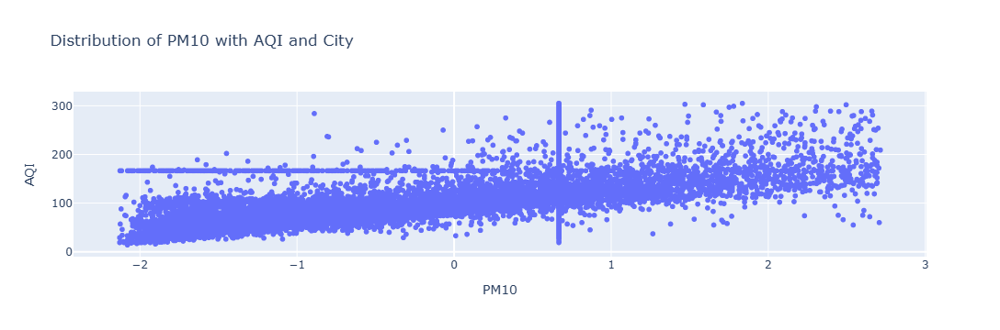

In [197]:
fig = px.scatter(df, x="PM10", y="AQI",
                 labels={'PM10':'PM10', 'AQI':'AQI'},
                 title='Distribution of PM10 with AQI and City',
                 hover_data={'City': True})

# Update layout to remove the legend
fig.update_layout(showlegend=False)

# Show the plot
fig.show()

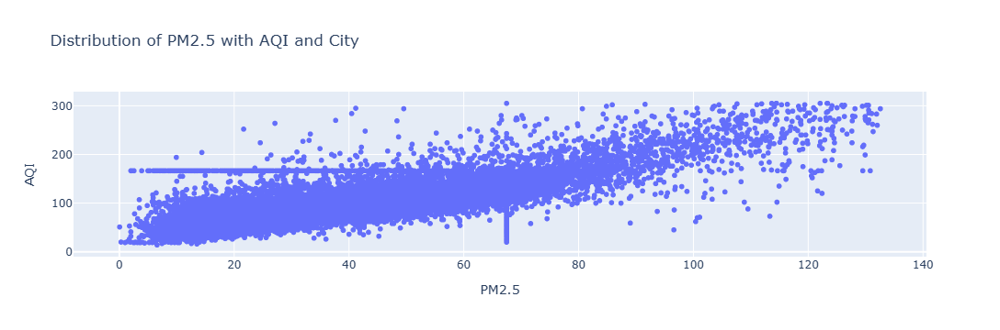

In [198]:
fig = px.scatter(df, x="PM2.5", y="AQI",
                 labels={'PM2.5':'PM2.5', 'AQI':'AQI'},
                 title='Distribution of PM2.5 with AQI and City',
                 hover_data={'City': True})

# Update layout to remove the legend
fig.update_layout(showlegend=False)

# Show the plot
fig.show()

Higher concentrations of PM2.5 and PM10 lead to an increase in AQI values. These fine particles can penetrate deep into the respiratory system,
causing health problems.

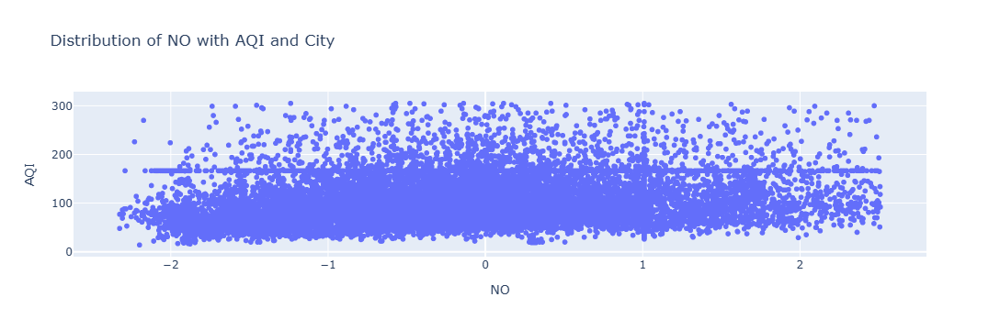

In [199]:
fig = px.scatter(df, x="NO", y="AQI",
                 labels={'NO':'NO', 'AQI':'AQI'},
                 title='Distribution of NO with AQI and City',
                 hover_data={'City': True})

# Update layout to remove the legend
fig.update_layout(showlegend=False)

# Show the plot
fig.show()

Increase: Higher concentrations of NO can lead to an increase in AQI values. NO is a precursor to nitrogen dioxide (NO2) and plays a role in the formation of ground-level ozone and other secondary pollutants.
Decrease: Lower NO concentrations result in lower AQI values, indicating cleaner air and reduced contributions to air pollution.

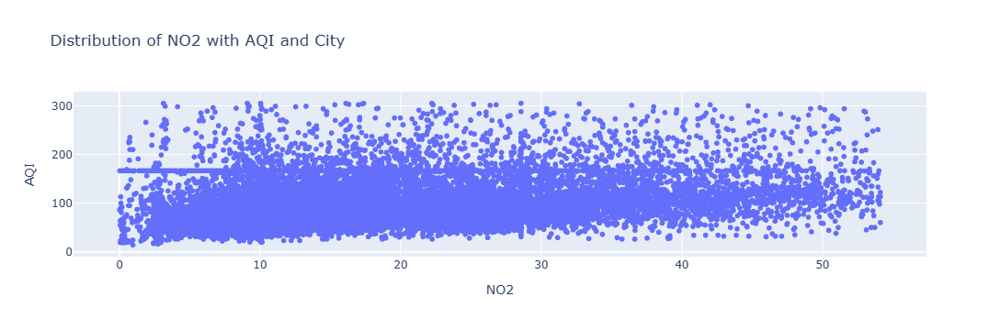

In [200]:
fig = px.scatter(df, x="NO2", y="AQI",
                 labels={'NO2':'NO2', 'AQI':'AQI'},
                 title='Distribution of NO2 with AQI and City',
                 hover_data={'City': True})

# Update layout to remove the legend
fig.update_layout(showlegend=False)

# Show the plot
fig.show()

Increase: Elevated levels of NO2 lead to higher AQI values. NO2 is a respiratory irritant and can contribute to the formation of
smog and acid rain.
Decrease: Reduced NO2 concentrations lead to lower AQI values, indicating cleaner air and lower risks to respiratory health.


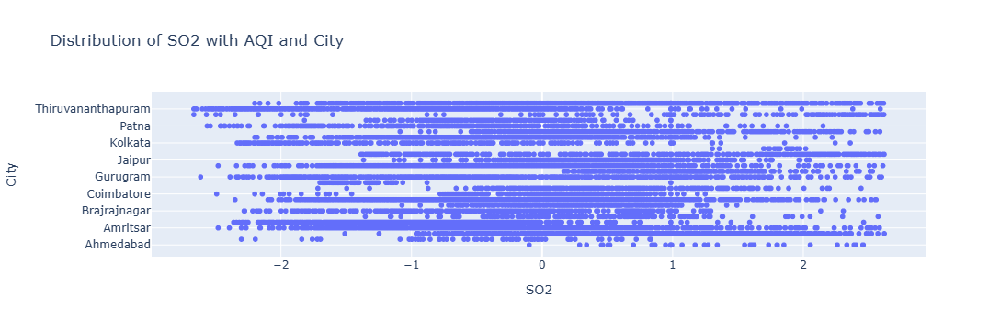

<Figure size 1200x800 with 0 Axes>

In [201]:
fig = px.scatter(df, x="SO2", y="City",
                 labels={'SO2':'SO2', 'City':'City'},
                 title='Distribution of SO2 with AQI and City',
                 hover_data={'AQI': True})

# Update layout to remove the legend
fig.update_layout(showlegend=False)
plt.figure(figsize=(12, 8))
# Show the plot
fig.show()

Increase: Higher levels of SO2 result in higher AQI values. SO2 can cause respiratory issues and contribute to the formation of acid rain.
Decrease: Lower SO2 concentrations lead to lower AQI values, indicating improved air quality and reduced environmental impacts.


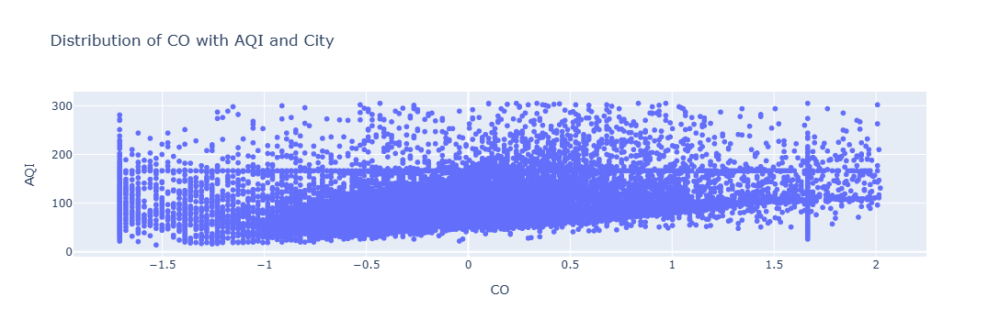

In [202]:
fig = px.scatter(df, x="CO", y="AQI",
                 labels={'CO':'CO', 'AQI':'AQI'},
                 title='Distribution of CO with AQI and City',
                 hover_data={'City': True})

# Update layout to remove the legend
fig.update_layout(showlegend=False)

# Show the plot
fig.show()


Increase: Elevated CO levels lead to higher AQI values. CO is a colorless, odorless gas that can be harmful when inhaled in high concentrations.
Decrease: Lower CO concentrations result in lower AQI values, indicating cleaner air and reduced risks of CO-related health problems.

## LABEL ENCODING

The dataset includes categorical data, such as "City", and "AQI_Bucket". We perform 'Label Encoding' to convert these categorical values into
numerical data.

Label Encoding assigns a unique numerical label to each category in a categorical feature. Algorithms used for computation, including those 
employed in machine learning, typically require numeric inputs for effective processing and analysis.

In [203]:
from sklearn.preprocessing import LabelEncoder

le=LabelEncoder()
df['City']=le.fit_transform(df['City'])
df['AQI_Bucket']=le.fit_transform(df['AQI_Bucket'])
df.head(2)

,City,PM2.5,PM10,NO,NO2,NOx,CO,SO2,O3,Benzene,Toluene,AQI,AQI_Bucket
Date,,,,,,,,,,,,,
2015-01-02,0,67.450578,0.666775,-1.889393,15.69,16.46,0.294183,2.260604,34.06,1.171014,5.50,166.463581,1
2015-01-04,0,67.450578,0.666775,-1.622286,18.48,17.97,1.168175,1.550394,36.08,1.387559,10.14,166.463581,1


Text(0.5, 1.0, 'Correlation Matrix Of AQI')

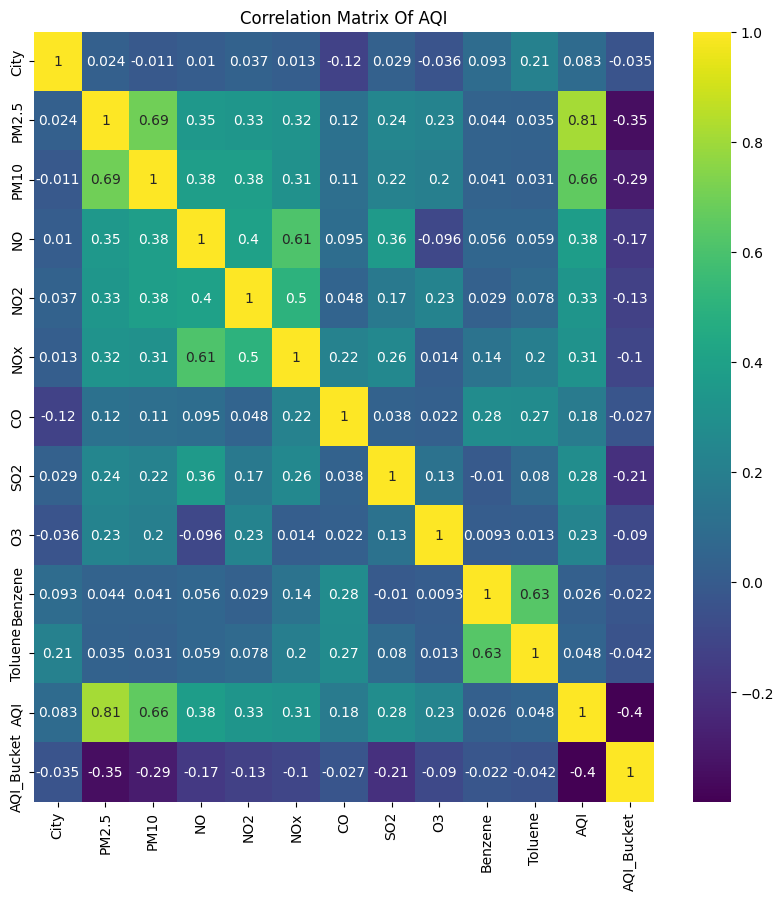

In [204]:
correlate=df.corr()
plt.figure(figsize=(10,10))
sns.heatmap(correlate,cmap='viridis',annot=True)
plt.title("Correlation Matrix Of AQI")

Here the features PM2.5 & PM10 are highly correlated with taget AQI. PM2.5 and PM10 shows a strong positive correlation. NOx shows a correlation with NO &NO2. Features like city and AQI_Bucket can be removed from the dataset ,since these features are not needed to predict the target variable AQI .NOx (Nitrogen Oxides) is essentially the sum of NO (Nitric Oxide) and NO2 (Nitrogen Dioxide). Because of this direct relationship, NOx will be highly correlated with both NO and NO2. Including NOx along with NO and NO2 in the same regression model will make it difficult to distinguish their individual effects on the dependent variable because changes in NO or NO2 will automatically imply changes in NOx.

In [205]:
df.drop('City',axis=1,inplace=True)
df.drop('NOx',axis=1,inplace=True)
df

,PM2.5,PM10,NO,NO2,CO,SO2,O3,Benzene,Toluene,AQI,AQI_Bucket
Date,,,,,,,,,,,
2015-01-02,67.450578,0.666775,-1.889393,15.690000,0.294183,2.260604,34.06000,1.171014,5.500000,166.463581,1
2015-01-04,67.450578,0.666775,-1.622286,18.480000,1.168175,1.550394,36.08000,1.387559,10.140000,166.463581,1
2015-01-10,67.450578,0.666775,1.009836,7.040000,1.664844,-0.098967,4.55000,-1.291959,0.000000,166.463581,1
2015-02-04,80.650000,0.666775,-1.413061,22.830000,1.761967,2.388649,47.30000,-1.291959,0.000000,294.000000,2
2015-02-26,67.450578,0.666775,1.009836,28.560659,1.664844,0.986073,34.49143,1.039485,8.700972,166.463581,1
...,...,...,...,...,...,...,...,...,...,...,...
2020-06-27,15.020000,-1.151760,-0.276559,25.060000,-0.549802,-0.045946,23.30000,0.620341,12.070000,41.000000,0
2020-06-28,24.380000,-0.558448,-1.130265,26.060000,-0.451771,0.704383,30.14000,-0.361112,2.210000,70.000000,3
2020-06-29,22.910000,-0.777519,-1.122809,29.530000,-0.529898,-0.072343,30.96000,-1.274748,0.010000,68.000000,3


## FEATURE SELECTION

In [206]:
from sklearn.feature_selection import SelectKBest, f_regression

# Define the feature matrix (X) and the target vector (y)
X = df.drop(['AQI','AQI_Bucket'],axis=1)
y = df['AQI']

# Apply SelectKBest to find the top features
k_best = SelectKBest(score_func=f_regression, k='all')  # 'all' means select all features
fit = k_best.fit(X, y)

# Get the scores for each feature
feature_scores = pd.DataFrame({'Feature': X.columns, 'Score': fit.scores_})
print(feature_scores.sort_values(by='Score', ascending=False))

   Feature         Score
0    PM2.5  34644.339415
1     PM10  13558.868490
2       NO   2899.508016
3      NO2   2172.113016
5      SO2   1533.768228
6       O3   1012.887331
4       CO    588.384513
8  Toluene     40.486489
7  Benzene     12.157072


In [207]:
# Select the top 7 features

k_best = SelectKBest(score_func=f_regression, k=7)
X_selected = k_best.fit_transform(X, y)
selected_features = X.columns[k_best.get_support()]
print("Selected Features: ", selected_features)

Selected Features:  Index(['PM2.5', 'PM10', 'NO', 'NO2', 'CO', 'SO2', 'O3'], dtype='object')


## FEATURE SCALING

In [208]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_selected)

## BUILD THE ML MODEL

In [209]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.model_selection import GridSearchCV

## Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Display the shapes of the training and testing sets
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)

X_train shape: (14158, 7)
y_train shape: (14158,)
X_test shape: (3540, 7)
y_test shape: (3540,)


## Linear Regression

In [210]:
# Train a Linear Regression model
lr = LinearRegression()
lr.fit(X_train, y_train)

## Predicting the values
y_pred = lr.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 734.64
Root Mean Squared Error: 27.10
Mean Absolute Error: 19.39
R^2 Score: 0.69


## Decision Tree Regressor 

In [211]:
tree_regressor = DecisionTreeRegressor(random_state=42)

# Train the model
tree_regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = tree_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 1046.13
Root Mean Squared Error: 32.34
Mean Absolute Error: 18.83
R^2 Score: 0.57


## Random Forest Regressor 

In [212]:
forest_regressor = RandomForestRegressor(random_state=42)

# Train the model
forest_regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = forest_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 492.13
Root Mean Squared Error: 22.18
Mean Absolute Error: 13.42
R^2 Score: 0.80


## MLP (Multi-Layer Perceptron) Regressor

In [213]:
mlp_regressor = MLPRegressor(random_state=42, max_iter=1000)

# Train the model
mlp_regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = mlp_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 537.33
Root Mean Squared Error: 23.18
Mean Absolute Error: 14.62
R^2 Score: 0.78


##  SVM (Support Vector Machine) Regressor 

In [214]:
# Build the SVM Regressor model
svm_regressor = SVR()

# Train the model
svm_regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = svm_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 649.38
Root Mean Squared Error: 25.48
Mean Absolute Error: 15.36
R^2 Score: 0.73


## AdaBoostRegressor

In [215]:
adaboost_regressor = AdaBoostRegressor(random_state=42)

# Train the model
adaboost_regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = adaboost_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 905.44
Root Mean Squared Error: 30.09
Mean Absolute Error: 23.27
R^2 Score: 0.62


## GradientBoostingRegressor

In [216]:
gbr_regressor = GradientBoostingRegressor(random_state=42)

# Train the model
gbr_regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = gbr_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 541.26
Root Mean Squared Error: 23.26
Mean Absolute Error: 14.75
R^2 Score: 0.78


## MODEL EVALUATION

In [217]:
model_names = ['Linear Regression', 'Decision tree regressor', 'Randomforest regressor', 'SVM regressor', 'Adaboost regressor', 'MLP regressor','Gradientboost regressor']
r2_scores = [.69, .57 , .80, .73, .62, .78 ,.78]

# Create a DataFrame from the data
data = {'Model': model_names, 'r2 Score': r2_scores}
dn = pd.DataFrame(data)
sorted_dn = dn.sort_values(by='r2 Score', ascending=False)
sorted_dn

,Model,r2 Score
2,Randomforest regressor,0.80
5,MLP regressor,0.78
6,Gradientboost regressor,0.78
3,SVM regressor,0.73
0,Linear Regression,0.69
4,Adaboost regressor,0.62
1,Decision tree regressor,0.57


### From the above models,Random forest regressor shows high perfomance

## Hyperparameter Tuning

Hyperparameters significantly influence the performance of a machine learning model.
Choosing the right hyperparameters can lead to better model accuracy, generalization, and efficiency.


In [218]:
# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

In [219]:
# Initialize the Random Forest Regressor
rf_regressor = RandomForestRegressor(random_state=42)

# Initialize GridSearchCV for hyperparameter tuning
grid_search = GridSearchCV(estimator=rf_regressor, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=2, n_jobs=-1)

# Perform GridSearchCV to find the best hyperparameters
grid_search.fit(X_train, y_train)


Fitting 5 folds for each of 243 candidates, totalling 1215 fits


GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [None, 5, 10],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]},
             scoring='neg_mean_squared_error', verbose=2)

In [220]:
# Get the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Use the best model for predictions
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

Best Hyperparameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 300}


In [221]:
# Evaluate the best model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.2f}')
print(f'Root Mean Squared Error: {rmse:.2f}')
print(f'Mean Absolute Error: {mae:.2f}')
print(f'R^2 Score: {r2:.2f}')

Mean Squared Error: 480.57
Root Mean Squared Error: 21.92
Mean Absolute Error: 13.40
R^2 Score: 0.80


## SAVE THE MODEL

In [222]:
import joblib
# Save the model to a file
joblib.dump(best_model, 'best_model.pkl')

# Load the model from the file
best_model = joblib.load('best_model.pkl')


## PREDICTION WITH UNSEEN DATA

In [223]:
# Sample data for demonstration

datas = {
    'PM2.5': [30, 28, 35, 25, 32],
    'PM10': [45, 40, 50, 35, 48],
    'NO2': [20, 22, 25, 18, 24],
    'SO2': [8, 7, 9, 6, 10],
    'CO': [0.5, 0.4, 0.6, 0.3, 0.7],
    'O3': [40, 38, 42, 36, 44],
    'NO': [15, 13, 17, 12, 16]
}

# Create a DataFrame
df2 = pd.DataFrame(datas)

# Display the dataframe
print("Unseen Data:")
print(df2)



Unseen Data:
   PM2.5  PM10  NO2  SO2   CO  O3  NO
0     30    45   20    8  0.5  40  15
1     28    40   22    7  0.4  38  13
2     35    50   25    9  0.6  42  17
3     25    35   18    6  0.3  36  12
4     32    48   24   10  0.7  44  16


In [224]:

# Load the saved best model
best_model = joblib.load('best_model.pkl')

# Define the feature columns
features=['PM2.5', 'PM10', 'NO2', 'SO2', 'CO', 'O3', 'NO']

# Extract features from unseen data
x_test = df2[features]
print("Shape of x_test:", x_test.shape)

# Make predictions
predictions = best_model.predict(x_test)
df2['Predicted_AQI'] = predictions
print(df2)



Shape of x_test: (5, 7)
   PM2.5  PM10  NO2  SO2   CO  O3  NO  Predicted_AQI
0     30    45   20    8  0.5  40  15     238.657847
1     28    40   22    7  0.4  38  13     239.062854
2     35    50   25    9  0.6  42  17     238.765387
3     25    35   18    6  0.3  36  12     238.593426
4     32    48   24   10  0.7  44  16     239.137553


In [225]:
# Predicting the value of AQI bucket

def AQI_Bucket(aqi):
    if aqi <=50:
        return"Good"
    elif aqi >50 and aqi <=100:
        return"Satisfactory"
    elif aqi >100 and aqi <=200:
        return"Moderate"
    elif aqi >200 and aqi <=300:
        return"Poor"
    elif aqi >300 and aqi <=400:
        return"Very Poor"
    elif aqi >400:
        return"Severe"
    else:
        return"Nothing"

# Step 4: Determine AQI bucket using a loop

aqi_buckets = []
for aqi in df2['Predicted_AQI']:
    bucket = AQI_Bucket(aqi)
    aqi_buckets.append(bucket)

df2['AQI_Bucket'] = aqi_buckets

# Display the first few rows with predictions and AQI bucket
print("\nUnseen Data with Predictions and AQI Buckets:")
print(df2)


Unseen Data with Predictions and AQI Buckets:
   PM2.5  PM10  NO2  SO2   CO  O3  NO  Predicted_AQI AQI_Bucket
0     30    45   20    8  0.5  40  15     238.657847       Poor
1     28    40   22    7  0.4  38  13     239.062854       Poor
2     35    50   25    9  0.6  42  17     238.765387       Poor
3     25    35   18    6  0.3  36  12     238.593426       Poor
4     32    48   24   10  0.7  44  16     239.137553       Poor


## CONCLUSION

In this study, we employed various machine learning algorithms to predict AQI levels based on a comprehensive dataset encompassing pollutant 
concentrations, Our analysis and findings contribute significantly to understanding air quality dynamics and enhancing AQI prediction accuracy.

 Firstly, our evaluation of multiple machine learning models revealed that the Random Forest Regression model outperformed others in predicting 
AQI levels. It achieved an r2 score of 0.80, with an RMSE of 21.92. This model demonstrated robustness in handling complex relationships between AQI 
and its influencing factors.Secondly, feature importance analysis highlighted the critical role of pollutant concentrations, particularly PM2.5 and
PM10, in determining AQI levels.

 The dataset may have been affected by sensor calibration issues or measurement errors, leading to inaccuracies in pollutant concentration readings.
Addressing these calibration challenges is crucial for enhancing the dataset's reliability and predictive accuracy.And also there are many null values in the dataset which may affect the perfomance of the model.

In conclusion, our study provides actionable insights for environmental agencies to develop effective strategies for air quality 
management. Recommendations include implementing stricter emission standards, enhancing green infrastructure, promoting sustainable transportation
, and leveraging predictive modeling for timely interventions. These efforts are crucial in achieving sustainable development goals and ensuring a 
healthier environment for future generations.